# 

In [102]:
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import numpy as np
df = pd.read_csv('data_full_sekrescon.csv')



In [103]:
df['index'] = df.index
df['load'] = df['thrusterAndPropulsion'] + df['hotelLoad']
df.loc[df['operationId'] == 100, 'operationId'] = 10
battery_dat = df['battery_0__actualPower'][70000:92000]
smol_df= df[70000:92000]

In [104]:
display(df)

,Unnamed: 0,datetime,battery_0__actualPower,thrusterAndPropulsion,sumEngMdoPower,hotelLoad,shorePowerEstimated,numberOfMdoEnginesRunning,operationId,dpMode,...,engMdoPerformance_1_,engMdoPerformance_2_,engMdoPerformance_3_,engMdoConsumption_0_,engMdoConsumption_1_,engMdoConsumption_2_,engMdoConsumption_3_,speedOverGround,index,load
0,0,2020-01-30 00:00:00,0,0.0,0,250.0,250,0,6,0,...,0.000,0,0.000,0.0,0.00,0.0,0.00,0.094,0,250.0
1,1,2020-01-30 00:00:00,0,0.0,0,250.0,250,0,6,0,...,0.000,0,0.000,0.0,0.00,0.0,0.00,0.022,1,250.0
2,2,2020-01-30 00:00:01,0,0.0,0,250.0,250,0,6,0,...,0.000,0,0.000,0.0,0.00,0.0,0.00,0.151,2,250.0
3,3,2020-01-30 00:00:02,1,0.0,0,250.0,249,0,6,0,...,0.000,0,0.000,0.0,0.00,0.0,0.00,0.080,3,250.0
4,4,2020-01-30 00:00:04,1,0.0,0,250.0,249,0,6,0,...,0.000,0,0.000,0.0,0.00,0.0,0.00,0.080,4,250.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
604795,604795,2020-02-05 23:59:55,-20,1386.0,2037,631.0,0,2,3,0,...,222.037,0,210.362,0.0,255.15,0.0,253.65,5.500,604795,2017.0
604796,604796,2020-02-05 23:59:56,11,1408.0,2009,612.0,0,2,3,0,...,212.690,0,235.104,0.0,259.90,0.0,258.75,5.240,604796,2020.0
604797,604797,2020-02-05 23:59:57,11,1430.0,2116,697.0,0,2,3,0,...,216.045,0,213.359,0.0,263.25,0.0,261.95,6.727,604797,2127.0
604798,604798,2020-02-05 23:59:58,17,1430.0,2015,602.0,0,2,3,0,...,223.550,0,222.416,0.0,263.35,0.0,256.10,7.917,604798,2032.0


In [105]:
socpros = np.zeros(604800)
soc = np.zeros(604800)

bat=df['battery_0__actualPower'].values.copy()
bat=bat/3600  # from kW-kWh


# state of charge
with a lossfactor of 97,5%, else the draf would forever go upwards, as there are more kWh charged than discharged.

In [106]:
soc[0] = 496
socpros[0] = 80
for i in range(len(soc)):
    if i == 0:
        pass
    elif i >=0 and bat[i] > 0:
        soc[i] = soc[i-1] - bat[i]
        socpros[i] = soc[i]/620*100
    elif i >=0 and bat[i] <= 0:
        soc[i] = soc[i-1] - bat[i]*0.975
        socpros[i] = soc[i]/620*100

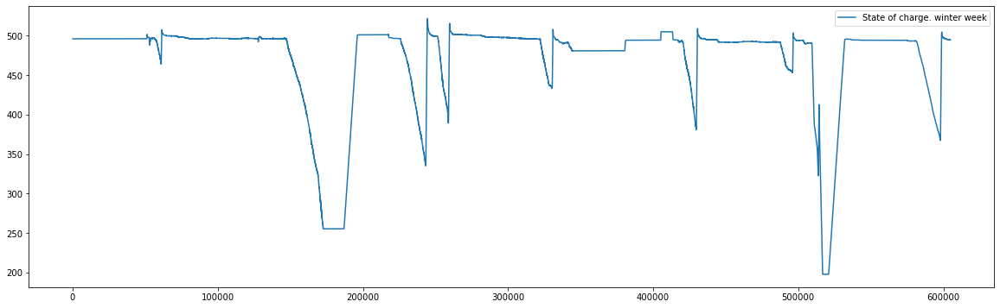

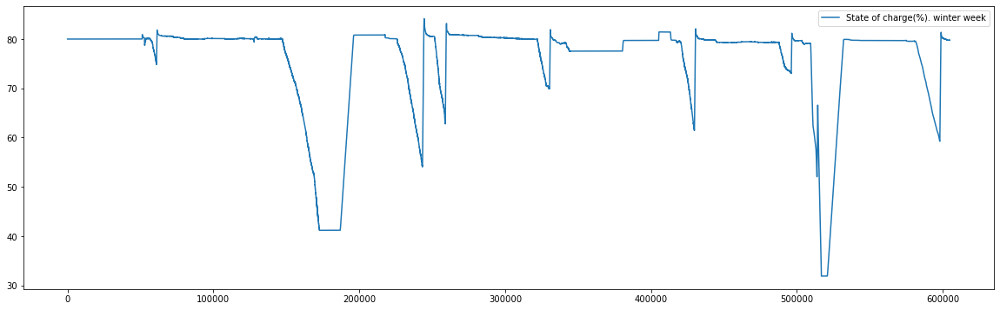

In [107]:
fig=plt.figure(figsize=(20,6))
plt.plot(soc,label='State of charge. winter week')
plt.legend()

fig=plt.figure(figsize=(20,6))
plt.plot(socpros,label='State of charge(%). winter week')
plt.legend()

In [112]:
i=0
J=604800
soc_over70=0
while i < j:
    if socpros[i]> 70:
        soc_over70+=1
    i+=1
print('times state of charge over 70%=',soc_over70)

times state of charge over 70%= 521834


In [113]:


bat=df['battery_0__actualPower'].values.copy()
bat=bat/3600

load_kwh=df['load'].values.copy()
load_kwh=load_kwh/3600

sumeng_kwh=df['sumEngMdoPower'].values.copy()
sumeng_kwh=sumeng_kwh/3600

travel_ms=df['speedOverGround'].values.copy()
travel_ms=travel_ms*0.514444 #make knop to m/s, since out data is 1 sec per point.
#prop_kwh=df['thrusterAndPropulsion'].values.copy()
#prop_kwh=prop_kwh/3600


df['soc'] = soc
df['soc %'] = socpros
#df['load_kwh'] = load_kwh
#df['prop_kwh'] = prop_kwh

#  mapping out how far the vessel has traveled


In [114]:
travel_plot=[0]*604800
for i in range(len(travel_plot)):
    if i == 0:
        pass
    else:
        travel_plot[i] = travel_plot[i-1] + travel_ms[i]/1000

In [115]:
print(travel_plot[603999])

1095.0799327091372


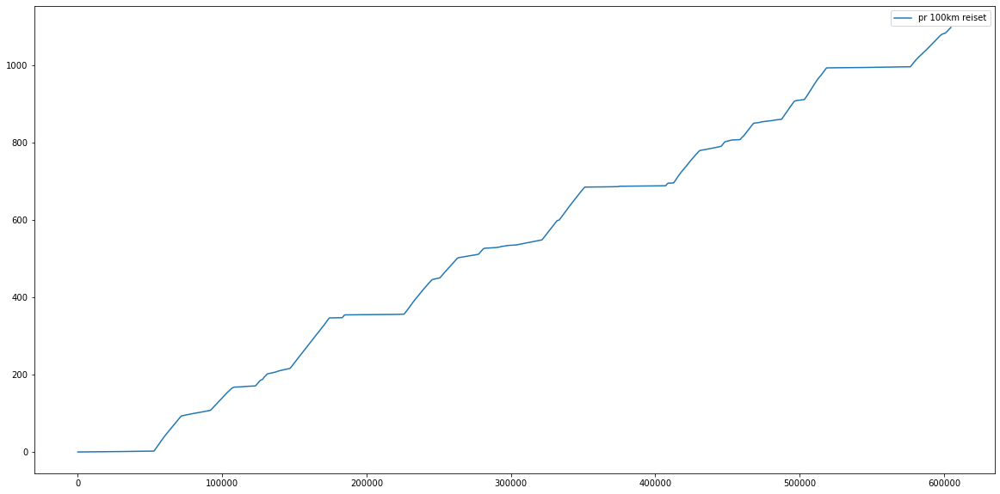

In [116]:
fig=plt.figure(figsize=(20,10))
plt.plot(travel_plot,label='pr 100km reiset')
plt.legend()


In [117]:
sumload_kwh=0
sumsumeng_kwh=0
for i in range(len(load_kwh)):
    sumload_kwh=load_kwh[i]+sumload_kwh
    sumsumeng_kwh=sumeng_kwh[i]+sumsumeng_kwh
print('total kWh for load=',sumload_kwh)
print('total kWh for all engines=',sumsumeng_kwh)
print('engine could be operated at 2100kW at ',sumsumeng_kwh/2100,'hours')


total kWh for load= 172655.31305504346
total kWh for all engines= 160250.12861110724
engine could be operated at 2100kW at  76.3095850529082 hours


In [118]:
posSUM=0
negSUM=0
for i in range(len(bat)):
    if i == 0:
        pass
    elif i <= 604798 and bat[i] > 0:
        posSUM=bat[i]+posSUM
    elif i <= 604798 and bat[i] <= 0:
        negSUM=bat[i]+negSUM
print(posSUM,negSUM)
eff=posSUM/negSUM
print(eff)

2549.5061111099967 -2613.363055553729
-0.9755652226321835


In [119]:
batpros=0
batpros=posSUM/sumsumeng_kwh*100
print(batpros)

1.5909541747059077


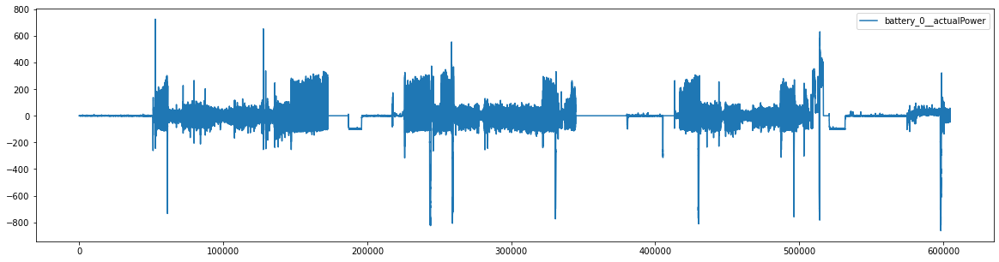

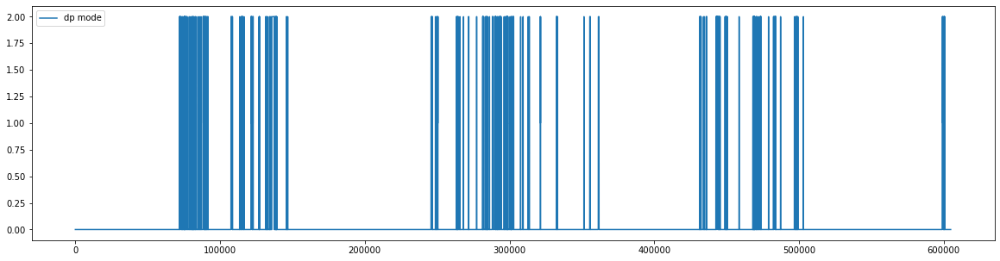

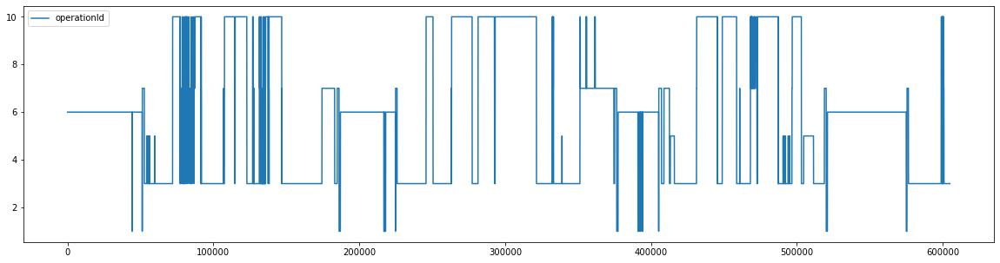

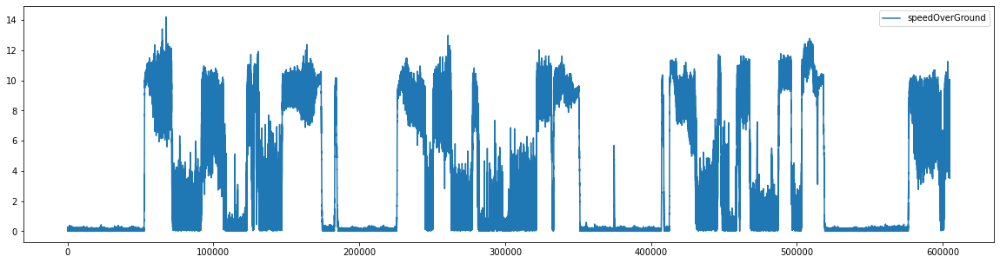

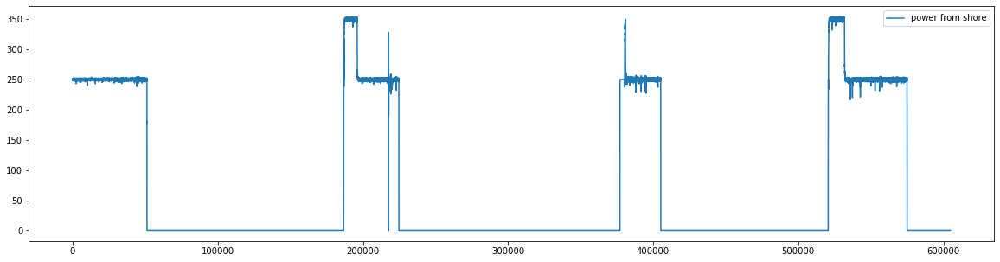

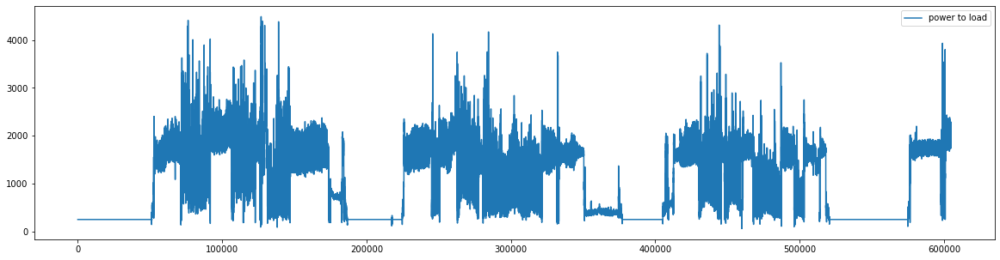

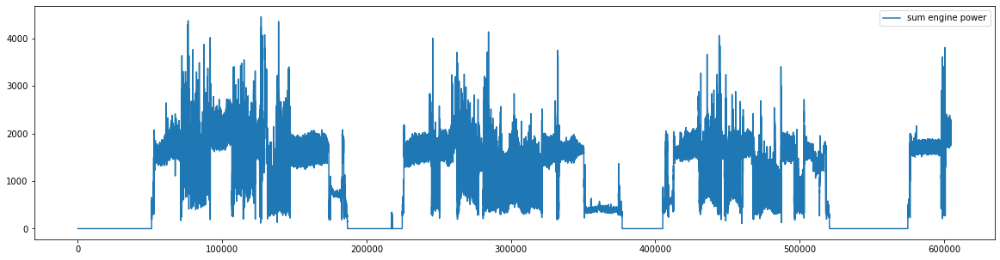

In [120]:
fig=plt.figure(figsize=(20,5))
plt.plot(df['battery_0__actualPower'],label='battery_0__actualPower')
plt.legend()
plt.show()

fig=plt.figure(figsize=(20,5))
plt.plot(df['dpMode'],label='dp mode')
plt.legend()
plt.show()

fig=plt.figure(figsize=(20,5))
plt.plot(df['operationId'],label='operationId')
plt.legend()
plt.show()

fig=plt.figure(figsize=(20,5))
plt.plot(df['speedOverGround'],label='speedOverGround')
plt.legend()
plt.show()

fig=plt.figure(figsize=(20,5))
plt.plot(df['shorePowerEstimated'],label='power from shore')
plt.legend()
plt.show()

fig=plt.figure(figsize=(20,5))
plt.plot(df['load'],label='power to load')
plt.legend()
plt.show()

fig=plt.figure(figsize=(20,5))
plt.plot(df['sumEngMdoPower'],label='sum engine power')
plt.legend()
plt.show()


In [121]:
plt.rcParams["figure.figsize"] = (20, 10)

<AxesSubplot:xlabel='index'>

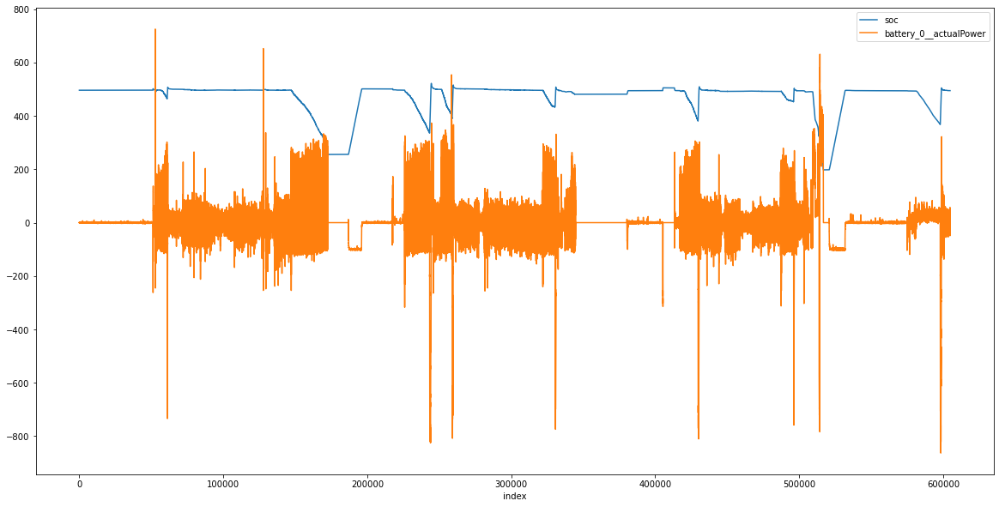

In [122]:
df.plot('index', ['soc', 'battery_0__actualPower'])


# 72000:91700, hour 20-25,5=5,5hr
DP mode+ litt standby

In [123]:
px.line(df[70000:95000],x='datetime',y="dpMode")

In [124]:
px.line(df[70000:95000], y="operationId")

In [125]:
px.line(df[70000:95000],x='datetime',y="soc")

In [126]:
px.line(df[70000:95000],x='datetime', y="speedOverGround")

In [127]:
px.line(df[70000:95000],x='datetime',y="sumEngMdoPower")

In [128]:
px.line(df[70000:92000],x='datetime', y="battery_0__actualPower")

In [129]:
posSUM=0
negSUM=0
sumload_kwh=0
sumsumeng_kwh=0
for i in range(len(bat[71990:75600])):
    if i<=71990:
        pass
    sumload_kwh=load_kwh[i]+sumload_kwh
    sumsumeng_kwh=sumeng_kwh[i]+sumsumeng_kwh
    if i > 0 and bat[i] > 0:
        posSUM=bat[i]+posSUM
    elif i >0 and bat[i] <= 0:
        negSUM=bat[i]+negSUM
print('total kWh for load=',sumload_kwh)
print('total kWh for all engines=',sumsumeng_kwh)
print(posSUM,negSUM)
eff=posSUM/negSUM
print(eff)

total kWh for load= 250.69444444446427
total kWh for all engines= 0.0
0.13305555555555568 -0.13333333333333347
-0.9979166666666666


In [130]:
posSUM=0
negSUM=0
sumload_kwh=0
sumsumeng_kwh=0
i=0+86400*0
j=i+86400*7
while i < j:
    sumload_kwh=load_kwh[i]+sumload_kwh
    sumsumeng_kwh=sumeng_kwh[i]+sumsumeng_kwh
    if bat[i] > 0:
        posSUM=bat[i]+posSUM
    elif bat[i] <= 0:
        negSUM=bat[i]+negSUM
    i += 1

print('total kWh for load=',sumload_kwh)
print('total kWh for all engines=',sumsumeng_kwh)
print('engine could be operated at 2100kW at ',sumsumeng_kwh/2100,'hours')
batpros=0
batpros=posSUM/sumsumeng_kwh*100
print('(battery discharged/sum engines used)*100 = ',batpros,'%')
print('discharged=',posSUM,'kWh')
print('charged=',negSUM,'kWh')
eff=posSUM/-negSUM*100
print('discharged/charged*100=',eff,'%')

total kWh for load= 172655.31305504346
total kWh for all engines= 160250.12861110724
engine could be operated at 2100kW at  76.3095850529082 hours
(battery discharged/sum engines used)*100 =  1.5909541747059077 %
discharged= 2549.5061111099967 kWh
charged= -2613.3633333315065 kWh
discharged/charged*100= 97.55651189380909 %


# 281385:321416, hour 78,16-89,28= day3 hour 6,16-17,28
DP mode+ litt standby

In [131]:
px.line(df[275000:325000], y="operationId")

In [132]:

px.line(df[275000:325000], y="dpMode")

In [133]:
px.line(df[275000:325000], y="battery_0__actualPower")

In [134]:
px.line(df[275000:325000], y="speedOverGround")